__Author: Christian Camilo Urcuqui López__

__Date: 20 March 2019__

# Game of Life

Proposed by the British John Horton Conway in 1970. It is a game a zero-player game, which its evolution is determined by its initial state, requiring no further input. Each component interacts with others and the idea of the game is to find patterns with particular properties. 

## Rules

The universe of the Game of Life is an infinite, two-dimensional orthogonal grid of square cells, each of which is in one of two possible states, __alive or dead__ (or populated and unpopulated, respectively). Every cell interacts with its eight neighbours, which are the cells that are horizontally, vertically, or diagonally adjacent. At each step in time, the following transitions occur:

+ Any live cell with fewer than two live neighbours dies, as if by __underpopulation__.
+ Any live cell with two or three live neighbours lives on to the next generation, it is know as __statis__.
+ Any live cell with more than three live neighbours dies, as if by __overpopulation__.
+ Any dead cell with exactly three live neighbours becomes a live cell, as if by __reproduction__.

Many patterns in the Game of Life eventually become a combination of still lifes, oscillators, and spaceships; other patterns may be called chaotic. A pattern may stay chaotic for a very long time until it eventually settles to such a combination.

Life is undecidable, which means that given an initial pattern and a later pattern, no algorithm exists that can tell whether the later pattern is ever going to appear.

In [1]:
import numpy as np

def life_step_1(X):
    """Game of life step using generator expressions"""
    nbrs_count = sum(np.roll(np.roll(X, i, 0), j, 1)
                     for i in (-1, 0, 1) for j in (-1, 0, 1)
                     if (i != 0 or j != 0))
    return (nbrs_count == 3) | (X & (nbrs_count == 2))

def life_step_2(X):
    """Game of life step using scipy tools"""
    from scipy.signal import convolve2d
    nbrs_count = convolve2d(X, np.ones((3, 3)), mode='same', boundary='wrap') - X
    return (nbrs_count == 3) | (X & (nbrs_count == 2))
    
life_step = life_step_1

In [2]:
%pylab inline

Populating the interactive namespace from numpy and matplotlib


In [27]:
# JSAnimation import available at https://github.com/jakevdp/JSAnimation
from JSAnimation.IPython_display import display_animation, anim_to_html
from matplotlib import animation

def life_animation(X, dpi=10, frames=10, interval=300, mode='loop'):
    """Produce a Game of Life Animation
    
    Parameters
    ----------
    X : array_like
        a two-dimensional numpy array showing the game board
    dpi : integer
        the number of dots per inch in the resulting animation.
        This controls the size of the game board on the screen
    frames : integer
        The number of frames to compute for the animation
    interval : float
        The time interval (in milliseconds) between frames
    mode : string
        The default mode of the animation.  Options are ['loop'|'once'|'reflect']
    """
    X = np.asarray(X)
    assert X.ndim == 2
    X = X.astype(bool)
    
    X_blank = np.zeros_like(X)
    figsize = (X.shape[1] * 1. / dpi, X.shape[0] * 1. / dpi)
    
    fig = plt.figure(figsize=figsize, dpi=dpi)
    
    ax = fig.add_axes([0, 0, 1, 1], xticks=[], yticks=[], frameon=False)
    
    ax.margins(1050, 50)      
    im = ax.imshow(X, cmap=plt.cm.binary, interpolation='nearest')
    im.set_clim(-0.05, 1)  # Make background gray

    # initialization function: plot the background of each frame
    def init():
        im.set_data(X_blank)
        return (im,)

    # animation function.  This is called sequentially
    def animate(i):
        im.set_data(animate.X)
        animate.X = life_step(animate.X)
        return (im,)
    animate.X = X

    anim = animation.FuncAnimation(fig, animate, init_func=init,
                                   frames=frames, interval=interval)
    
    #print anim_to_html(anim)
    return display_animation(anim, default_mode=mode)


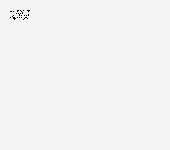
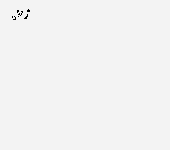
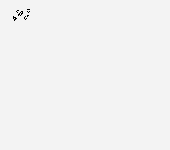
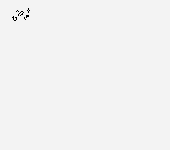
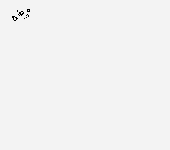
...
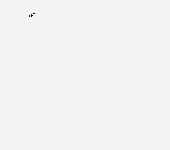
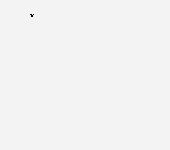
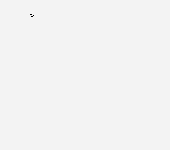
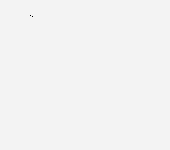
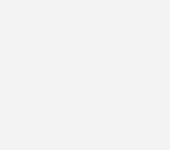

In [28]:
np.random.seed(0)
X = np.zeros((150, 170), dtype=bool)
r = np.random.random((10, 20))
X[10:20, 10:30] = (r > 0.75)
life_animation(X, dpi=10, frames=40, mode='once')

## Static configurations

In [29]:
X = np.zeros((6, 21))
X[2:4, 1:3] = 1
X[1:4, 5:9] = [[0, 1, 1, 0],
               [1, 0, 0, 1],
               [0, 1, 1, 0]]
X[1:5, 11:15] = [[0, 1, 1, 0],
                 [1, 0, 0, 1],
                 [0, 1, 0, 1],
                 [0, 0, 1, 0]]
X[1:4, 17:20] = [[1, 1, 0],
                 [1, 0, 1],
                 [0, 1, 0]]

life_animation(X, dpi=5, frames=3)

## The "Blinker" and the "Toad"

In [31]:
blinker = [1, 1, 1]
toad = [[1, 1, 1, 0],
        [0, 1, 1, 1]]

X = np.zeros((6, 11))
X[2, 1:4] = blinker
X[2:4, 6:10] = toad
life_animation(X, dpi=5, frames=4)

## The "Pulsar"

In [33]:
X = np.zeros((17, 17))
X[2, 4:7] = 1
X[4:7, 7] = 1
X += X.T
X += X[:, ::-1]
X += X[::-1, :]
life_animation(X, frames=6)

## The "Glider"

In [35]:
glider = [[1, 0, 0],
          [0, 1, 1],
          [1, 1, 0]]
X = np.zeros((8, 8))
X[:3, :3] = glider
life_animation(X, dpi=5, frames=32, interval=100)

## The "Gosper Glider Gun"


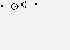
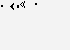
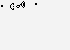
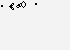
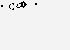
...
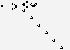
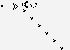
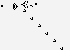
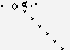
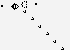

In [36]:
glider_gun =\
[[0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0],
 [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0],
 [0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1,1],
 [0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1,1],
 [1,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0],
 [1,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0],
 [0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0],
 [0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0],
 [0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0]]

X = np.zeros((50, 70))
X[1:10,1:37] = glider_gun

life_animation(X, dpi=15, frames=180, interval=50, mode='once')

## Going further

<img src="http://upload.wikimedia.org/wikipedia/commons/e/e6/Conways_game_of_life_breeder_animation.gif">

In [5]:
%%HTML
<iframe width="900" height="506" src="https://www.youtube.com/embed/VmHNtGhtZ6s" frameborder="0" allow="accelerometer; autoplay; encrypted-media; gyroscope; picture-in-picture" allowfullscreen></iframe>

In [3]:
%%HTML
<iframe width="900" height="506" src="https://www.youtube.com/embed/wQQ2NHECcvQ" frameborder="0" allow="accelerometer; autoplay; encrypted-media; gyroscope; picture-in-picture" allowfullscreen></iframe>

> GEN: 0 BEST: 132 AVG: 25.94 WORST: 0
> GEN: 1 BEST: 189 AVG: 68.16 WORST: 23
> GEN: 2 BEST: 168 AVG: 68.78 WORST: 8
> GEN: 3 BEST: 189 AVG: 70.72 WORST: 7


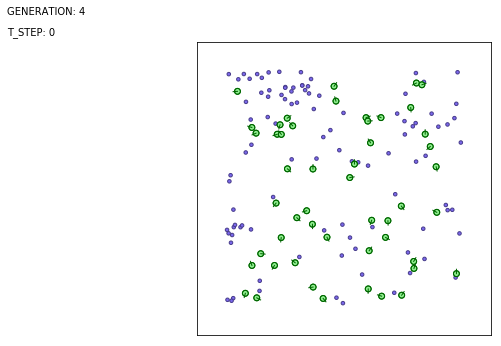

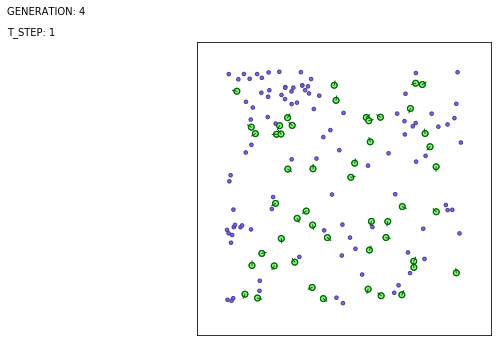

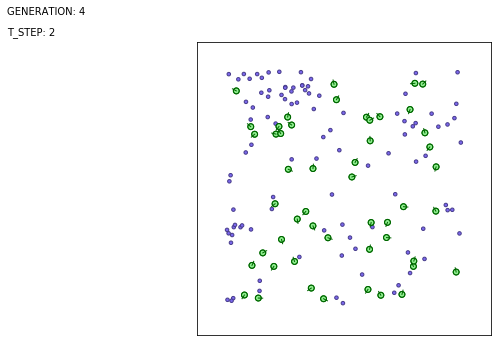

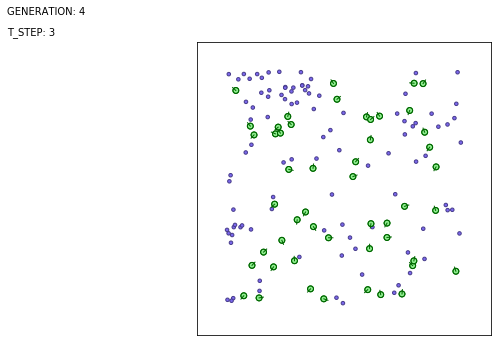

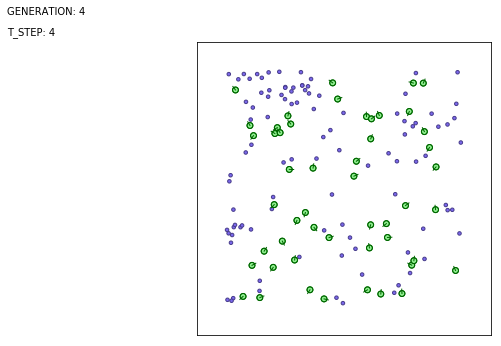

...

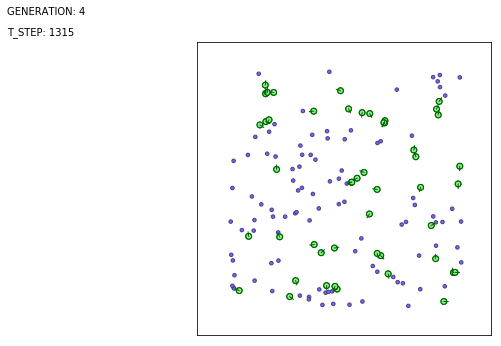

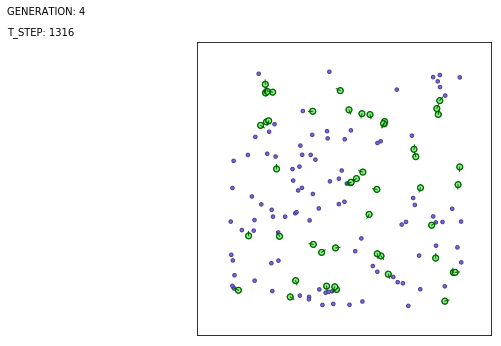

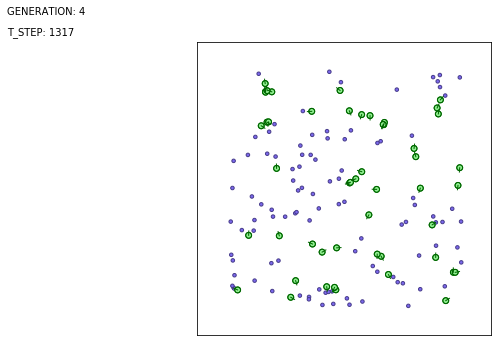

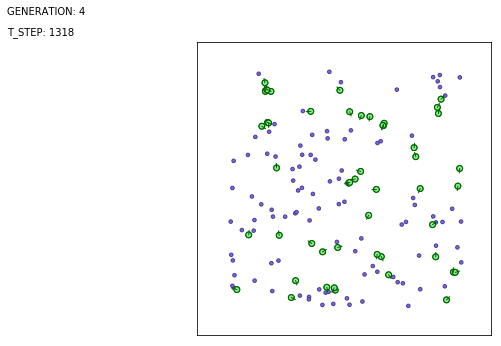

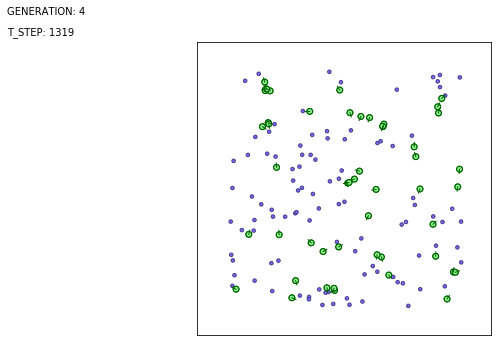

In [ ]:

#------------------------------------------------------------------------------+
#
#   Nathan A. Rooy
#   Evolving Simple Organisms
#   2017-Nov.
#   https://github.com/nathanrooy/evolving-simple-organisms
#------------------------------------------------------------------------------+

#--- IMPORT DEPENDENCIES ------------------------------------------------------+

from __future__ import division, print_function
from collections import defaultdict

from matplotlib import pyplot as plt
from matplotlib.patches import Circle
import matplotlib.lines as lines

from plotting import plot_food
from plotting import plot_organism

import numpy as np
import operator

from math import atan2
from math import cos
from math import degrees
from math import floor
from math import radians
from math import sin
from math import sqrt
from random import randint
from random import random
from random import sample
from random import uniform

#--- CONSTANTS ----------------------------------------------------------------+

settings = {}

# EVOLUTION SETTINGS
settings['pop_size'] = 50       # number of organisms
settings['food_num'] = 100      # number of food particles
settings['gens'] = 5           # number of generations
settings['elitism'] = 0.20      # elitism (selection bias)
settings['mutate'] = 0.10       # mutation rate

# SIMULATION SETTINGS
settings['gen_time'] = 100      # generation length         (seconds)
settings['dt'] = 0.04           # simulation time step      (dt)
settings['dr_max'] = 720        # max rotational speed      (degrees per second)
settings['v_max'] = 0.5         # max velocity              (units per second)
settings['dv_max'] =  0.25      # max acceleration (+/-)    (units per second^2)

settings['x_min'] = -2.0        # arena western border
settings['x_max'] =  2.0        # arena eastern border
settings['y_min'] = -2.0        # arena southern border
settings['y_max'] =  2.0        # arena northern border

settings['plot'] = True        # plot final generation?

# ORGANISM NEURAL NET SETTINGS
settings['inodes'] = 1          # number of input nodes
settings['hnodes'] = 5          # number of hidden nodes
settings['onodes'] = 2          # number of output nodes

#--- FUNCTIONS ----------------------------------------------------------------+

def dist(x1,y1,x2,y2):
    return sqrt((x2-x1)**2 + (y2-y1)**2)


def calc_heading(org, food):
    d_x = food.x - org.x
    d_y = food.y - org.y
    theta_d = degrees(atan2(d_y, d_x)) - org.r
    if abs(theta_d) > 180: theta_d += 360
    return theta_d / 180


def plot_frame(settings, organisms, foods, gen, time):
    fig, ax = plt.subplots()
    fig.set_size_inches(9.6, 5.4)

    plt.xlim([settings['x_min'] + settings['x_min'] * 0.25, settings['x_max'] + settings['x_max'] * 0.25])
    plt.ylim([settings['y_min'] + settings['y_min'] * 0.25, settings['y_max'] + settings['y_max'] * 0.25])

    # PLOT ORGANISMS
    for organism in organisms:
        plot_organism(organism.x, organism.y, organism.r, ax)

    # PLOT FOOD PARTICLES
    for food in foods:
        plot_food(food.x, food.y, ax)

    # MISC PLOT SETTINGS
    ax.set_aspect('equal')
    frame = plt.gca()
    frame.axes.get_xaxis().set_ticks([])
    frame.axes.get_yaxis().set_ticks([])

    plt.figtext(0.025, 0.95,r'GENERATION: '+str(gen))
    plt.figtext(0.025, 0.90,r'T_STEP: '+str(time))

    plt.savefig(str(gen)+'-'+str(time)+'.png', dpi=100)
    plt.show()


def evolve(settings, organisms_old, gen):

    elitism_num = int(floor(settings['elitism'] * settings['pop_size']))
    new_orgs = settings['pop_size'] - elitism_num

    #--- GET STATS FROM CURRENT GENERATION ----------------+
    stats = defaultdict(int)
    for org in organisms_old:
        if org.fitness > stats['BEST'] or stats['BEST'] == 0:
            stats['BEST'] = org.fitness

        if org.fitness < stats['WORST'] or stats['WORST'] == 0:
            stats['WORST'] = org.fitness

        stats['SUM'] += org.fitness
        stats['COUNT'] += 1

    stats['AVG'] = stats['SUM'] / stats['COUNT']


    #--- ELITISM (KEEP BEST PERFORMING ORGANISMS) ---------+
    orgs_sorted = sorted(organisms_old, key=operator.attrgetter('fitness'), reverse=True)
    organisms_new = []
    for i in range(0, elitism_num):
        organisms_new.append(organism(settings, wih=orgs_sorted[i].wih, who=orgs_sorted[i].who, name=orgs_sorted[i].name))


    #--- GENERATE NEW ORGANISMS ---------------------------+
    for w in range(0, new_orgs):

        # SELECTION (TRUNCATION SELECTION)
        canidates = range(0, elitism_num)
        random_index = sample(canidates, 2)
        org_1 = orgs_sorted[random_index[0]]
        org_2 = orgs_sorted[random_index[1]]

        # CROSSOVER
        crossover_weight = random()
        wih_new = (crossover_weight * org_1.wih) + ((1 - crossover_weight) * org_2.wih)
        who_new = (crossover_weight * org_1.who) + ((1 - crossover_weight) * org_2.who)

        # MUTATION
        mutate = random()
        if mutate <= settings['mutate']:

            # PICK WHICH WEIGHT MATRIX TO MUTATE
            mat_pick = randint(0,1)

            # MUTATE: WIH WEIGHTS
            if mat_pick == 0:
                index_row = randint(0,settings['hnodes']-1)
                wih_new[index_row] = wih_new[index_row] * uniform(0.9, 1.1)
                if wih_new[index_row] >  1: wih_new[index_row] = 1
                if wih_new[index_row] < -1: wih_new[index_row] = -1

            # MUTATE: WHO WEIGHTS
            if mat_pick == 1:
                index_row = randint(0,settings['onodes']-1)
                index_col = randint(0,settings['hnodes']-1)
                who_new[index_row][index_col] = who_new[index_row][index_col] * uniform(0.9, 1.1)
                if who_new[index_row][index_col] >  1: who_new[index_row][index_col] = 1
                if who_new[index_row][index_col] < -1: who_new[index_row][index_col] = -1

        organisms_new.append(organism(settings, wih=wih_new, who=who_new, name='gen['+str(gen)+']-org['+str(w)+']'))

    return organisms_new, stats


def simulate(settings, organisms, foods, gen):

    total_time_steps = int(settings['gen_time'] / settings['dt'])

    #--- CYCLE THROUGH EACH TIME STEP ---------------------+
    for t_step in range(0, total_time_steps, 1):

        # PLOT SIMULATION FRAME
        if settings['plot']==True and gen==settings['gens']-1:
            plot_frame(settings, organisms, foods, gen, t_step)

        # UPDATE FITNESS FUNCTION
        for food in foods:
            for org in organisms:
                food_org_dist = dist(org.x, org.y, food.x, food.y)

                # UPDATE FITNESS FUNCTION
                if food_org_dist <= 0.075:
                    org.fitness += food.energy
                    food.respawn(settings)

                # RESET DISTANCE AND HEADING TO NEAREST FOOD SOURCE
                org.d_food = 100
                org.r_food = 0

        # CALCULATE HEADING TO NEAREST FOOD SOURCE
        for food in foods:
            for org in organisms:

                # CALCULATE DISTANCE TO SELECTED FOOD PARTICLE
                food_org_dist = dist(org.x, org.y, food.x, food.y)

                # DETERMINE IF THIS IS THE CLOSEST FOOD PARTICLE
                if food_org_dist < org.d_food:
                    org.d_food = food_org_dist
                    org.r_food = calc_heading(org, food)

        # GET ORGANISM RESPONSE
        for org in organisms:
            org.think()

        # UPDATE ORGANISMS POSITION AND VELOCITY
        for org in organisms:
            org.update_r(settings)
            org.update_vel(settings)
            org.update_pos(settings)

    return organisms


#--- CLASSES ------------------------------------------------------------------+


class food():
    def __init__(self, settings):
        self.x = uniform(settings['x_min'], settings['x_max'])
        self.y = uniform(settings['y_min'], settings['y_max'])
        self.energy = 1


    def respawn(self,settings):
        self.x = uniform(settings['x_min'], settings['x_max'])
        self.y = uniform(settings['y_min'], settings['y_max'])
        self.energy = 1


class organism():
    def __init__(self, settings, wih=None, who=None, name=None):

        self.x = uniform(settings['x_min'], settings['x_max'])  # position (x)
        self.y = uniform(settings['y_min'], settings['y_max'])  # position (y)

        self.r = uniform(0,360)                 # orientation   [0, 360]
        self.v = uniform(0,settings['v_max'])   # velocity      [0, v_max]
        self.dv = uniform(-settings['dv_max'], settings['dv_max'])   # dv

        self.d_food = 100   # distance to nearest food
        self.r_food = 0     # orientation to nearest food
        self.fitness = 0    # fitness (food count)

        self.wih = wih
        self.who = who

        self.name = name


    # NEURAL NETWORK
    def think(self):

        # SIMPLE MLP
        af = lambda x: np.tanh(x)               # activation function
        h1 = af(np.dot(self.wih, self.r_food))  # hidden layer
        out = af(np.dot(self.who, h1))          # output layer

        # UPDATE dv AND dr WITH MLP RESPONSE
        self.nn_dv = float(out[0])   # [-1, 1]  (accelerate=1, deaccelerate=-1)
        self.nn_dr = float(out[1])   # [-1, 1]  (left=1, right=-1)


    # UPDATE HEADING
    def update_r(self, settings):
        self.r += self.nn_dr * settings['dr_max'] * settings['dt']
        self.r = self.r % 360


    # UPDATE VELOCITY
    def update_vel(self, settings):
        self.v += self.nn_dv * settings['dv_max'] * settings['dt']
        if self.v < 0: self.v = 0
        if self.v > settings['v_max']: self.v = settings['v_max']


    # UPDATE POSITION
    def update_pos(self, settings):
        dx = self.v * cos(radians(self.r)) * settings['dt']
        dy = self.v * sin(radians(self.r)) * settings['dt']
        self.x += dx
        self.y += dy


#--- MAIN ---------------------------------------------------------------------+


def run(settings):

    #--- POPULATE THE ENVIRONMENT WITH FOOD ---------------+
    foods = []
    for i in range(0,settings['food_num']):
        foods.append(food(settings))

    #--- POPULATE THE ENVIRONMENT WITH ORGANISMS ----------+
    organisms = []
    for i in range(0,settings['pop_size']):
        wih_init = np.random.uniform(-1, 1, (settings['hnodes'], settings['inodes']))     # mlp weights (input -> hidden)
        who_init = np.random.uniform(-1, 1, (settings['onodes'], settings['hnodes']))     # mlp weights (hidden -> output)

        organisms.append(organism(settings, wih_init, who_init, name='gen[x]-org['+str(i)+']'))

    #--- CYCLE THROUGH EACH GENERATION --------------------+
    for gen in range(0, settings['gens']):

        # SIMULATE
        organisms = simulate(settings, organisms, foods, gen)

        # EVOLVE
        organisms, stats = evolve(settings, organisms, gen)
        print('> GEN:',gen,'BEST:',stats['BEST'],'AVG:',stats['AVG'],'WORST:',stats['WORST'])

    pass


#--- RUN ----------------------------------------------------------------------+

run(settings)

#--- END ----------------------------------------------------------------------+

## References
+ http://psych.utoronto.ca/users/reingold/courses/ai/alife.html
+ https://en.wikipedia.org/wiki/Conway%27s_Game_of_Life
+ https://hongkong.codeconf.io/assets/slides/How%20to%20Evolve%20Life.pdf
+ https://jakevdp.github.io/blog/2013/08/07/conways-game-of-life/
+ https://github.com/nathanrooy/evolving-simple-organisms